In [45]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score,precision_score,recall_score,f1_score,jaccard_score
from sklearn.metrics import jaccard_score
from sklearn.naive_bayes import GaussianNB

## Data

### loading Data

In [2]:
!pip install --upgrade --no-cache-dir gdown

  Attempting uninstall: gdown
    Found existing installation: gdown 5.1.0
    Uninstalling gdown-5.1.0:
      Successfully uninstalled gdown-5.1.0


In [46]:
!gdown 1QkjBaYL-2i6APLjCi-AEkMVtWmKTXzQK

Downloading...
From: https://drive.google.com/uc?id=1QkjBaYL-2i6APLjCi-AEkMVtWmKTXzQK
To: /content/heart.csv
100% 38.1k/38.1k [00:00<00:00, 73.0MB/s]


In [47]:
data = pd.read_csv('heart.csv')
data.head()


,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,52,1,0,125,212,0,1,168,0,1.0,2,2,3,0
1,53,1,0,140,203,1,0,155,1,3.1,0,0,3,0
2,70,1,0,145,174,0,1,125,1,2.6,0,0,3,0
3,61,1,0,148,203,0,1,161,0,0.0,2,1,3,0
4,62,0,0,138,294,1,1,106,0,1.9,1,3,2,0


### Data info

In [5]:
#dir(data)
data?

In [6]:
print(data.columns)
print(data.shape)


Index(['age', 'sex', 'cp', 'trestbps', 'chol', 'fbs', 'restecg', 'thalach',
       'exang', 'oldpeak', 'slope', 'ca', 'thal', 'target'],
      dtype='object')
(1025, 14)


In [7]:
data.describe()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
count,1025.000000,1025.000000,1025.000000,1025.000000,1025.00000,1025.000000,1025.000000,1025.000000,1025.000000,1025.000000,1025.000000,1025.000000,1025.000000,1025.000000
mean,54.434146,0.695610,0.942439,131.611707,246.00000,0.149268,0.529756,149.114146,0.336585,1.071512,1.385366,0.754146,2.323902,0.513171
std,9.072290,0.460373,1.029641,17.516718,51.59251,0.356527,0.527878,23.005724,0.472772,1.175053,0.617755,1.030798,0.620660,0.500070
min,29.000000,0.000000,0.000000,94.000000,126.00000,0.000000,0.000000,71.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,48.000000,0.000000,0.000000,120.000000,211.00000,0.000000,0.000000,132.000000,0.000000,0.000000,1.000000,0.000000,2.000000,0.000000
50%,56.000000,1.000000,1.000000,130.000000,240.00000,0.000000,1.000000,152.000000,0.000000,0.800000,1.000000,0.000000,2.000000,1.000000
75%,61.000000,1.000000,2.000000,140.000000,275.00000,0.000000,1.000000,166.000000,1.000000,1.800000,2.000000,1.000000,3.000000,1.000000
max,77.000000,1.000000,3.000000,200.000000,564.00000,1.000000,2.000000,202.000000,1.000000,6.200000,2.000000,4.000000,3.000000,1.000000


In [8]:
data.head()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,52,1,0,125,212,0,1,168,0,1.0,2,2,3,0
1,53,1,0,140,203,1,0,155,1,3.1,0,0,3,0
2,70,1,0,145,174,0,1,125,1,2.6,0,0,3,0
3,61,1,0,148,203,0,1,161,0,0.0,2,1,3,0
4,62,0,0,138,294,1,1,106,0,1.9,1,3,2,0


In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1025 entries, 0 to 1024
Data columns (total 14 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       1025 non-null   int64  
 1   sex       1025 non-null   int64  
 2   cp        1025 non-null   int64  
 3   trestbps  1025 non-null   int64  
 4   chol      1025 non-null   int64  
 5   fbs       1025 non-null   int64  
 6   restecg   1025 non-null   int64  
 7   thalach   1025 non-null   int64  
 8   exang     1025 non-null   int64  
 9   oldpeak   1025 non-null   float64
 10  slope     1025 non-null   int64  
 11  ca        1025 non-null   int64  
 12  thal      1025 non-null   int64  
 13  target    1025 non-null   int64  
dtypes: float64(1), int64(13)
memory usage: 112.2 KB


array([[<Axes: title={'center': 'age'}>, <Axes: title={'center': 'sex'}>,
        <Axes: title={'center': 'cp'}>,
        <Axes: title={'center': 'trestbps'}>],
       [<Axes: title={'center': 'chol'}>,
        <Axes: title={'center': 'fbs'}>,
        <Axes: title={'center': 'restecg'}>,
        <Axes: title={'center': 'thalach'}>],
       [<Axes: title={'center': 'exang'}>,
        <Axes: title={'center': 'oldpeak'}>,
        <Axes: title={'center': 'slope'}>,
        <Axes: title={'center': 'ca'}>],
       [<Axes: title={'center': 'thal'}>,
        <Axes: title={'center': 'target'}>, <Axes: >, <Axes: >]],
      dtype=object)

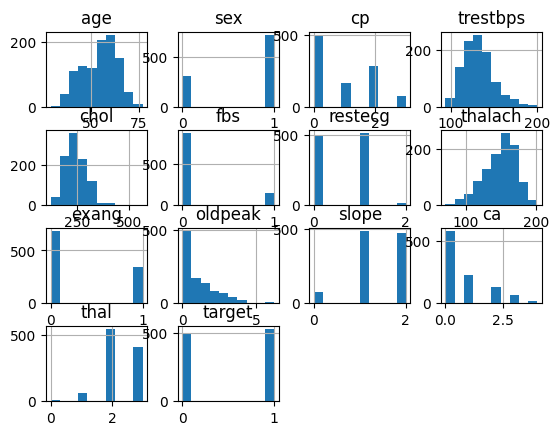

In [10]:
data.hist()

In [11]:
cor=data.corr()
print(cor)

               age       sex        cp  trestbps      chol       fbs  \
age       1.000000 -0.103240 -0.071966  0.271121  0.219823  0.121243   
sex      -0.103240  1.000000 -0.041119 -0.078974 -0.198258  0.027200   
cp       -0.071966 -0.041119  1.000000  0.038177 -0.081641  0.079294   
trestbps  0.271121 -0.078974  0.038177  1.000000  0.127977  0.181767   
chol      0.219823 -0.198258 -0.081641  0.127977  1.000000  0.026917   
fbs       0.121243  0.027200  0.079294  0.181767  0.026917  1.000000   
restecg  -0.132696 -0.055117  0.043581 -0.123794 -0.147410 -0.104051   
thalach  -0.390227 -0.049365  0.306839 -0.039264 -0.021772 -0.008866   
exang     0.088163  0.139157 -0.401513  0.061197  0.067382  0.049261   
oldpeak   0.208137  0.084687 -0.174733  0.187434  0.064880  0.010859   
slope    -0.169105 -0.026666  0.131633 -0.120445 -0.014248 -0.061902   
ca        0.271551  0.111729 -0.176206  0.104554  0.074259  0.137156   
thal      0.072297  0.198424 -0.163341  0.059276  0.100244 -0.04

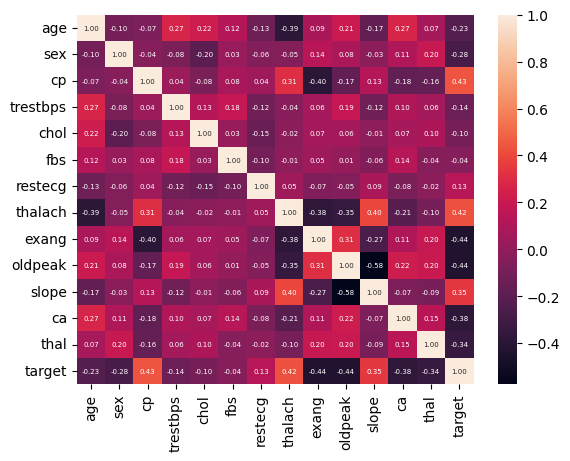

In [30]:
cor=data.corr()
fig, ax = plt.subplots()
ax = sns.heatmap(cor, annot=True, annot_kws={"size": 5}, fmt=".2f")



### Plots

#### age

(age
 29     4
 34     6
 35    15
 37     6
 38    12
 39    14
 40    11
 41    32
 42    26
 43    26
 44    36
 45    25
 46    23
 47    18
 48    23
 49    17
 50    21
 51    39
 52    43
 53    26
 54    53
 55    30
 56    39
 57    57
 58    68
 59    46
 60    37
 61    31
 62    37
 63    32
 64    34
 65    27
 66    25
 67    31
 68    12
 69     9
 70    14
 71    11
 74     3
 76     3
 77     3
 dtype: int64,
 <Axes: xlabel='age', ylabel='count'>)

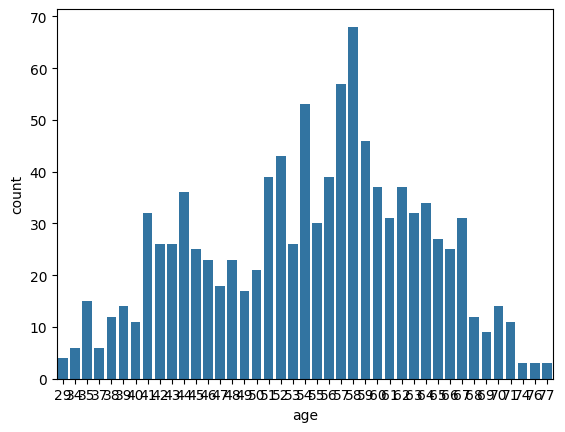

In [14]:
data.groupby('age').size() , sns.countplot(x='age', data=data)

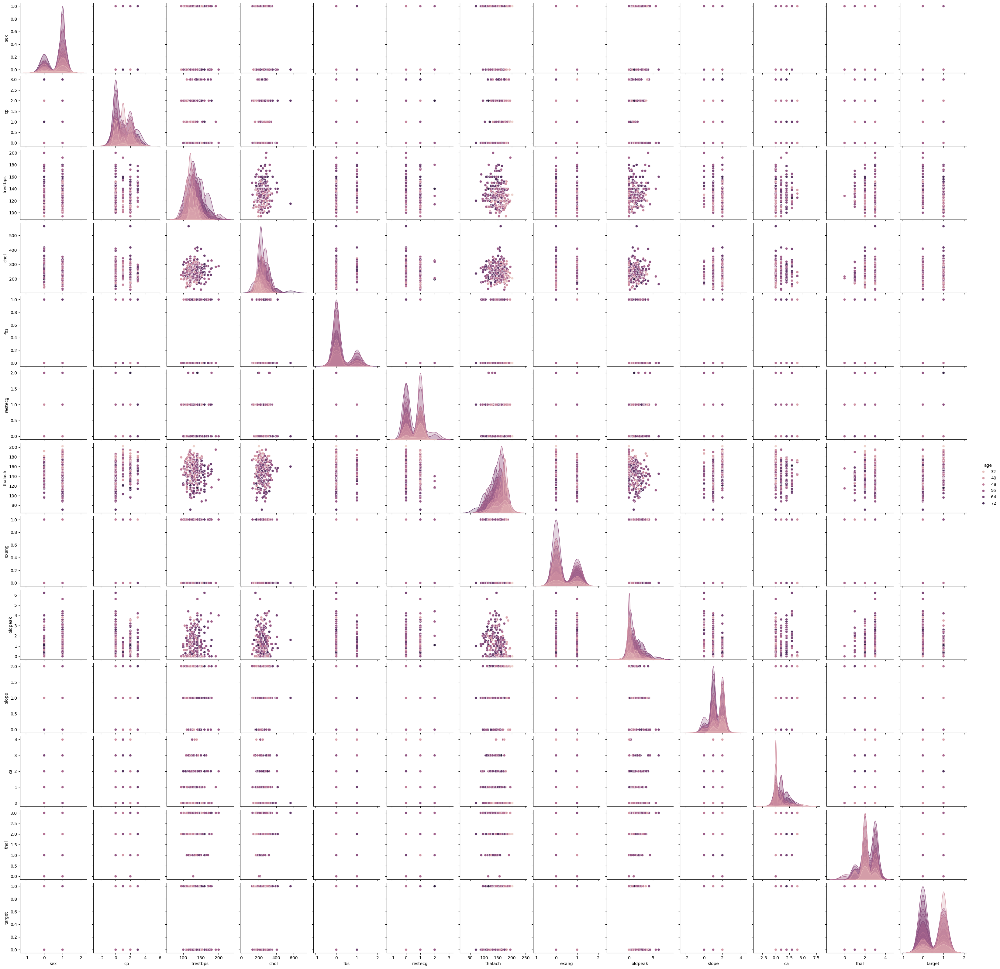

In [ ]:
sns.pairplot(data,hue='age')

#### sex

(sex
 0    312
 1    713
 dtype: int64,
 <Axes: xlabel='sex', ylabel='count'>)

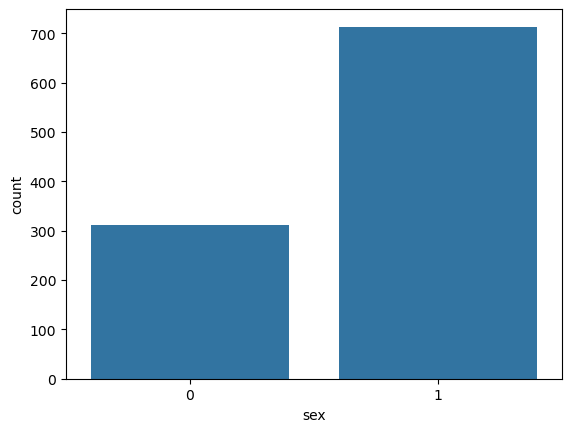

In [ ]:
data.groupby('sex').size() , sns.countplot(x='sex', data=data)

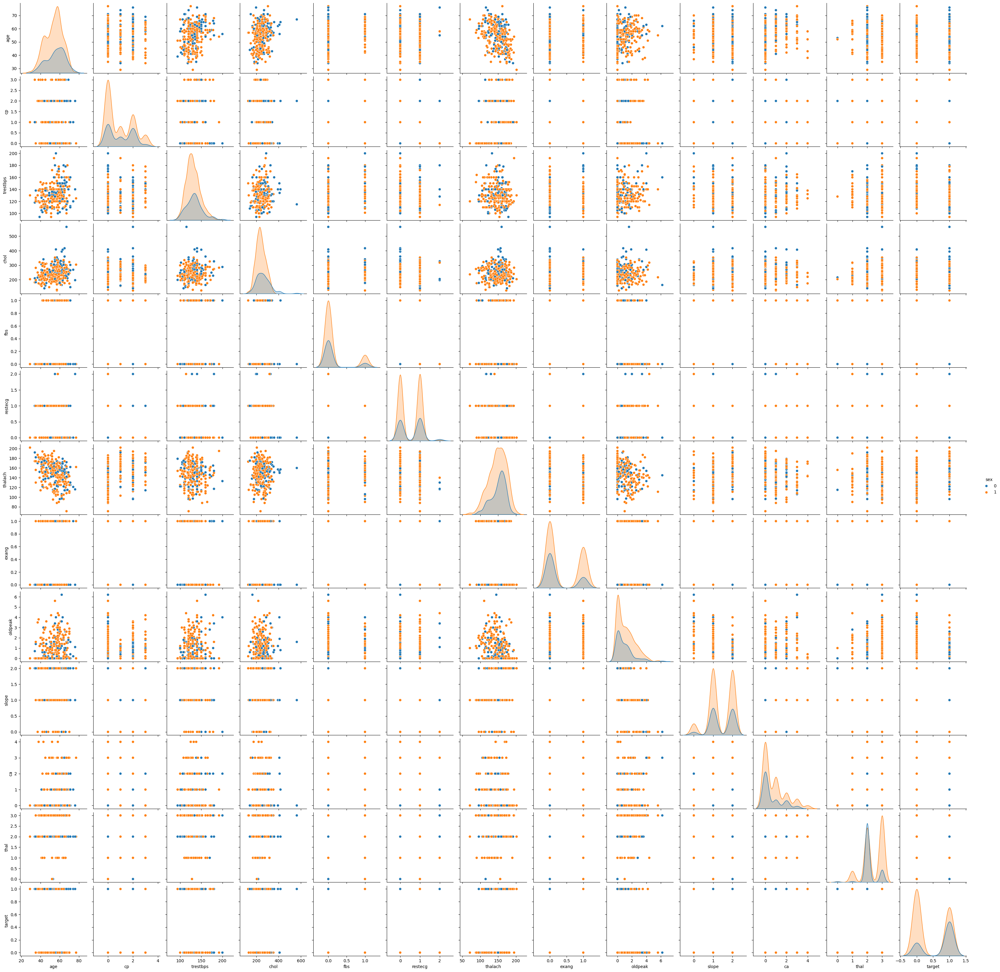

In [ ]:
sns.pairplot(data,hue='sex')

#### cp

(cp
 0    497
 1    167
 2    284
 3     77
 dtype: int64,
 <Axes: xlabel='cp', ylabel='count'>)

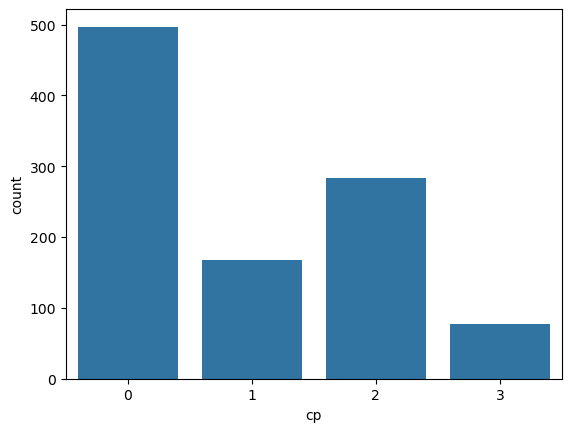

In [ ]:
data.groupby('cp').size(), sns.countplot(x='cp', data=data)

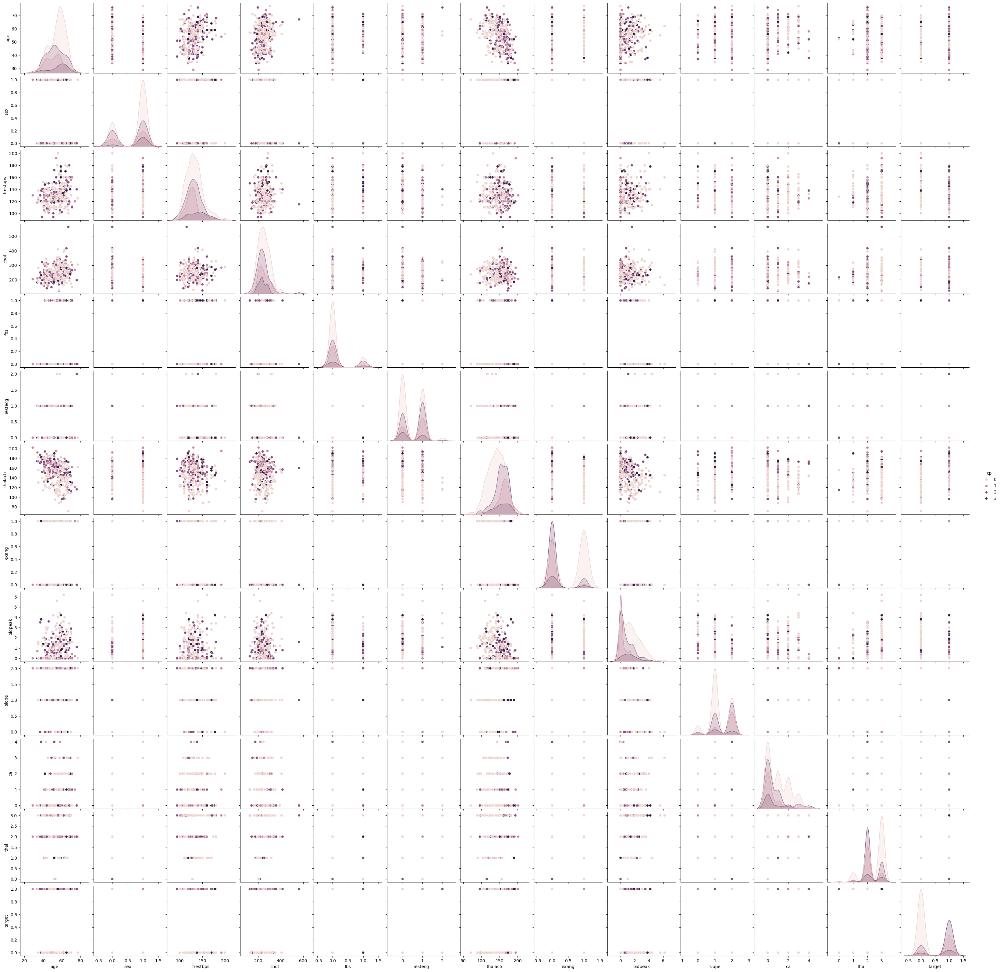

In [ ]:
sns.pairplot(data,hue='cp')

#### trestbps

(trestbps
 94       7
 100     14
 101      3
 102      6
 104      3
 105      9
 106      3
 108     21
 110     64
 112     30
 114      4
 115      9
 117      4
 118     24
 120    128
 122     14
 123      4
 124     20
 125     38
 126     10
 128     39
 129      3
 130    123
 132     28
 134     17
 135     20
 136     11
 138     45
 140    107
 142      9
 144      6
 145     17
 146      8
 148      7
 150     55
 152     17
 154      4
 155      3
 156      3
 160     36
 164      3
 165      4
 170     15
 172      3
 174      3
 178      7
 180     10
 192      3
 200      4
 dtype: int64,
 <Axes: xlabel='trestbps', ylabel='count'>)

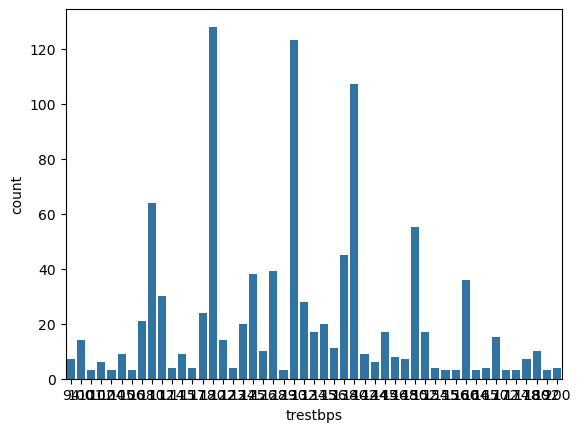

In [ ]:
data.groupby('trestbps').size() , sns.countplot(x='trestbps', data=data)

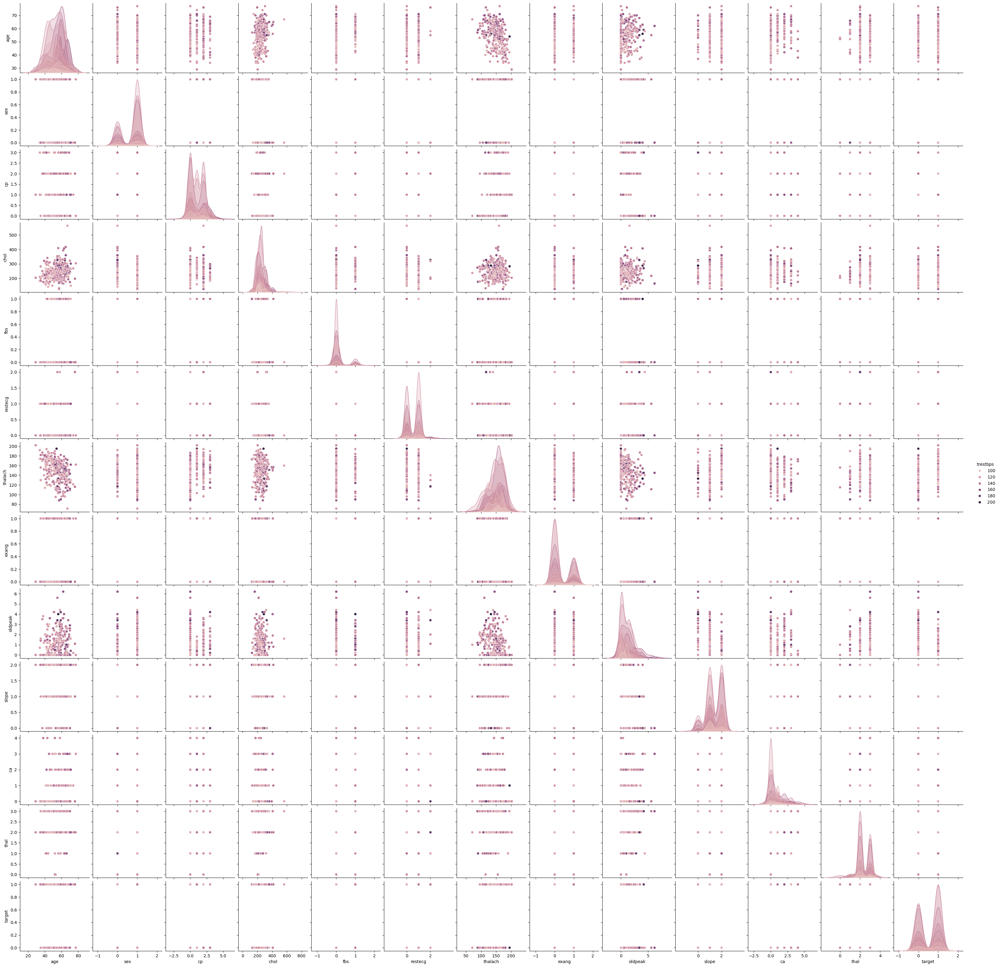

In [ ]:
sns.pairplot(data,hue='trestbps')

#### chol

(chol
 126    3
 131    3
 141    3
 149    8
 157    4
       ..
 394    3
 407    4
 409    3
 417    3
 564    3
 Length: 152, dtype: int64,
 <Axes: xlabel='chol', ylabel='count'>)

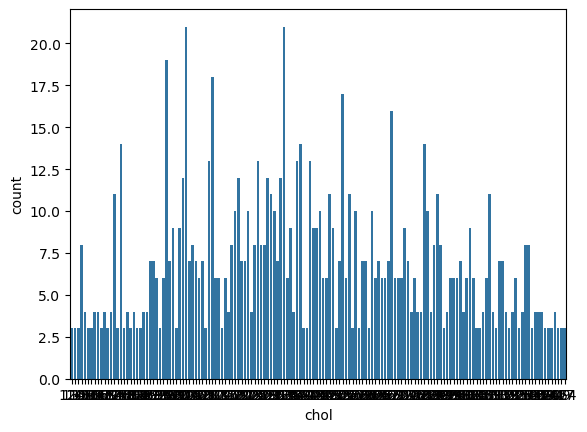

In [ ]:
data.groupby('chol').size() , sns.countplot(x='chol', data=data)

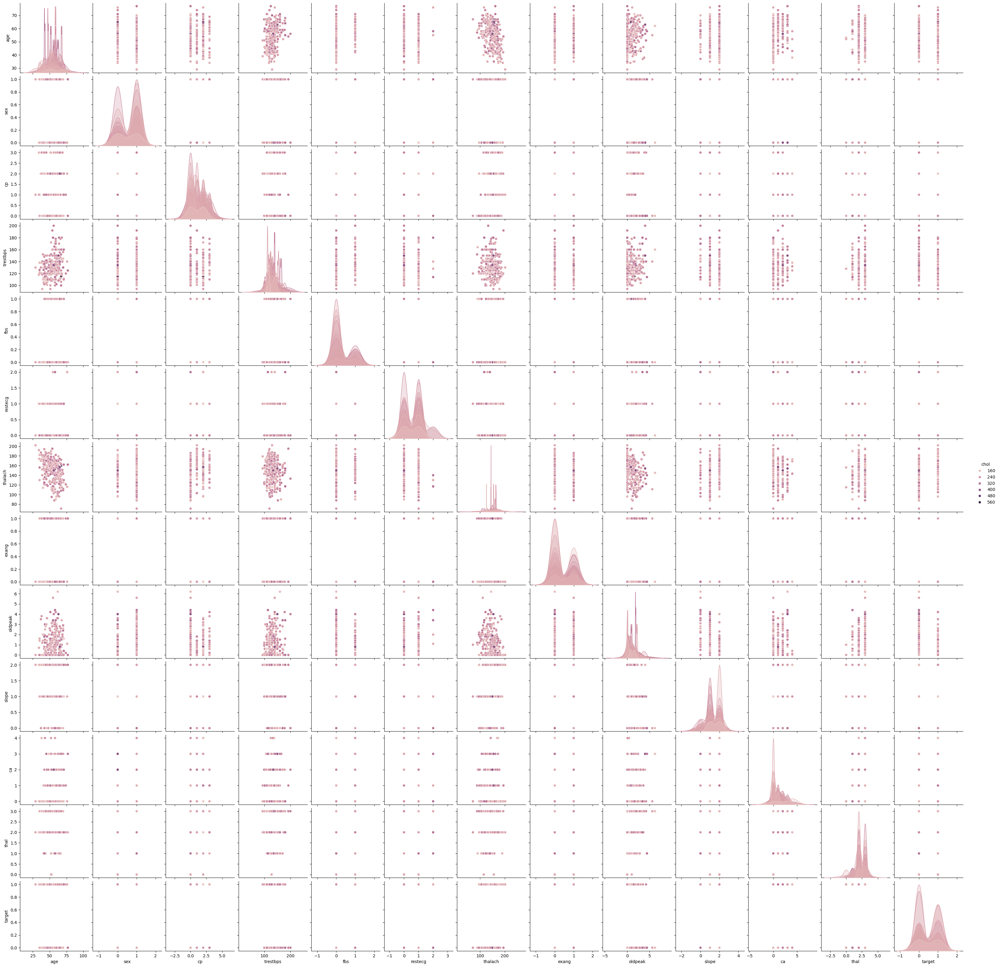

In [ ]:
sns.pairplot(data,hue='chol')

#### fbs

(fbs
 0    872
 1    153
 dtype: int64,
 <Axes: xlabel='fbs', ylabel='count'>)

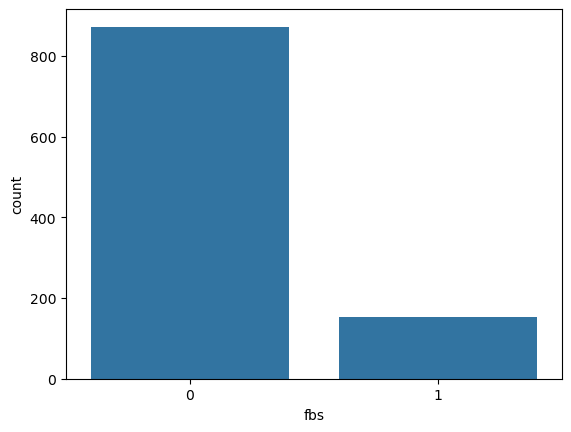

In [ ]:
data.groupby('fbs').size(), sns.countplot(x='fbs', data=data)

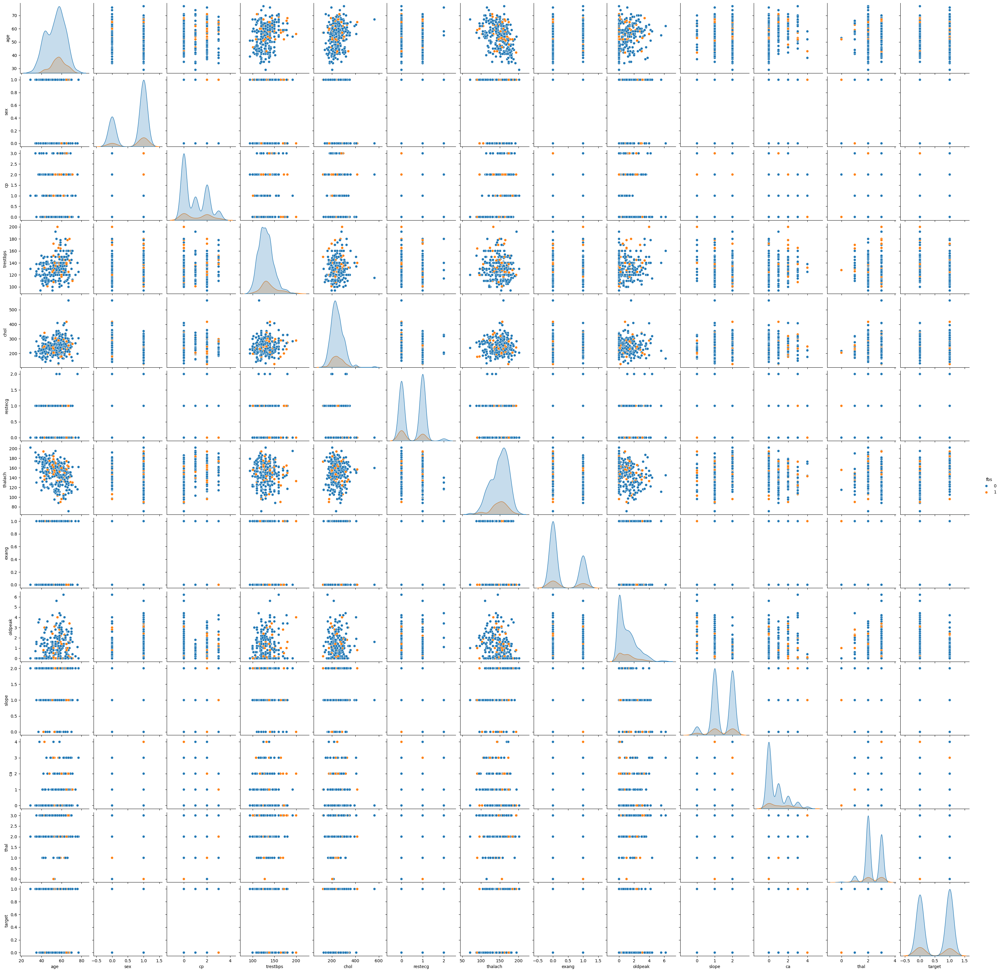

In [ ]:
sns.pairplot(data,hue='fbs')

#### restecg

(restecg
 0    497
 1    513
 2     15
 dtype: int64,
 <Axes: xlabel='restecg', ylabel='count'>)

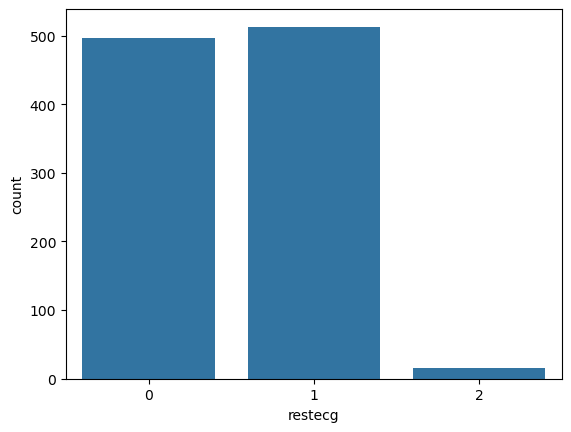

In [ ]:
data.groupby('restecg').size(), sns.countplot(x='restecg', data=data)

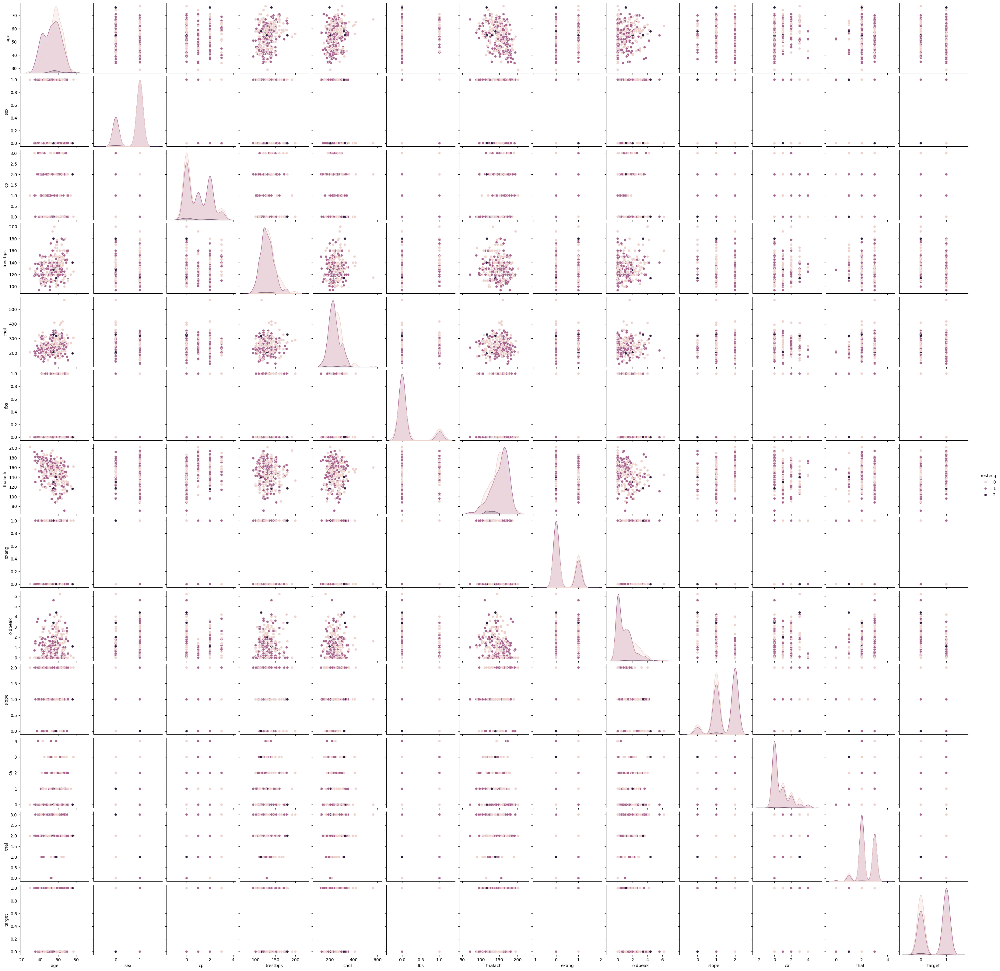

In [ ]:
sns.pairplot(data,hue='restecg')

#### thalach

(thalach
 71     4
 88     3
 90     3
 95     4
 96     7
       ..
 190    4
 192    3
 194    3
 195    3
 202    4
 Length: 91, dtype: int64,
 <Axes: xlabel='thalach', ylabel='count'>)

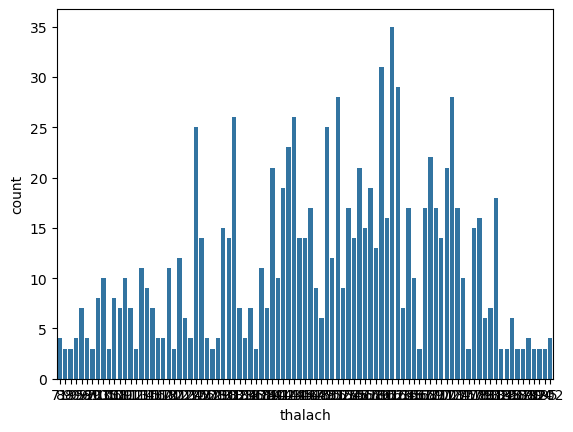

In [ ]:
data.groupby('thalach').size() , sns.countplot(x='thalach', data=data)

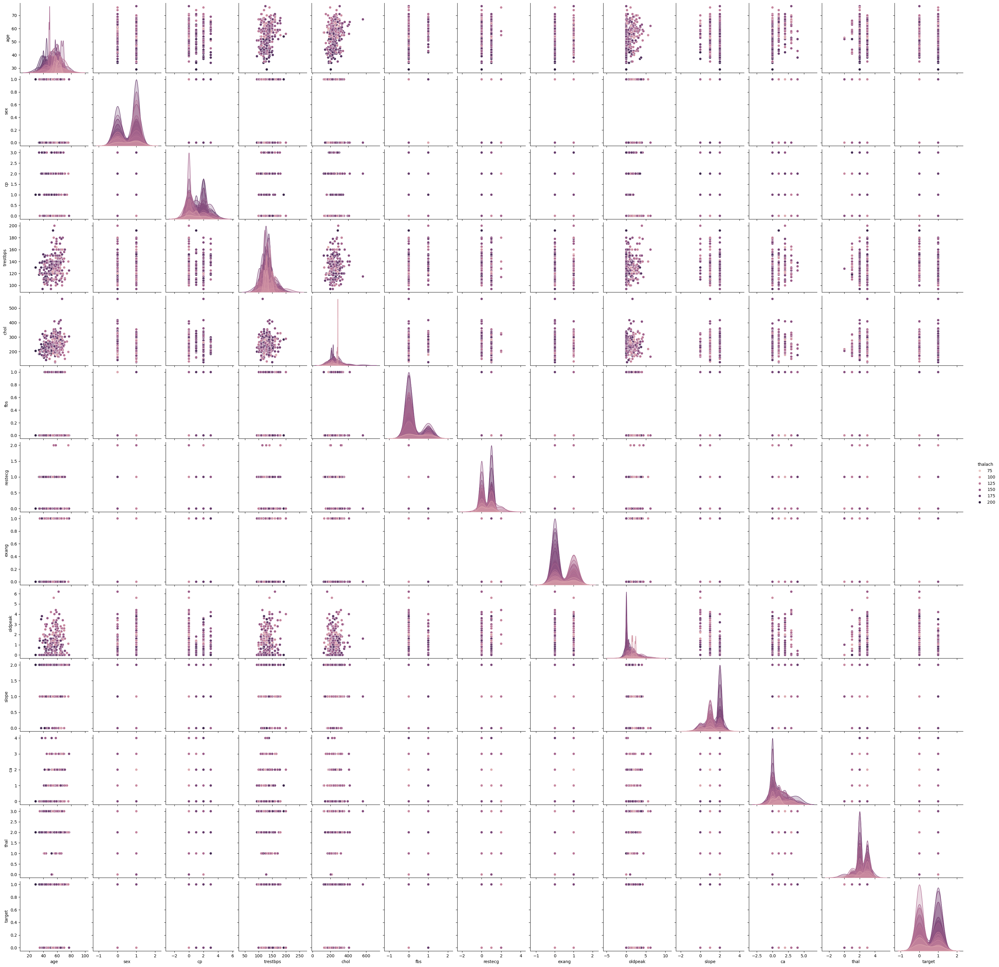

In [ ]:
sns.pairplot(data,hue='thalach')

#### exang

(exang
 0    680
 1    345
 dtype: int64,
 <Axes: xlabel='exang', ylabel='count'>)

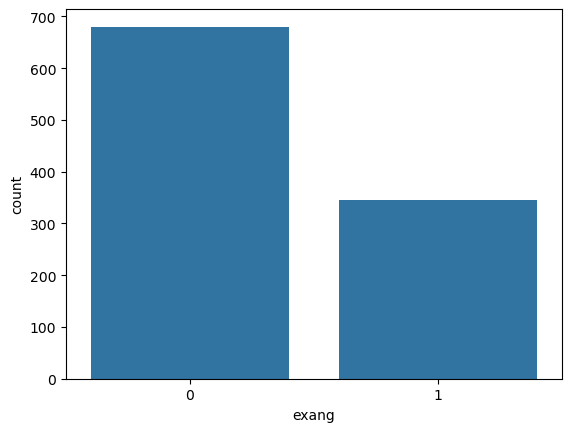

In [ ]:
data.groupby('exang').size() , sns.countplot(x='exang', data=data)

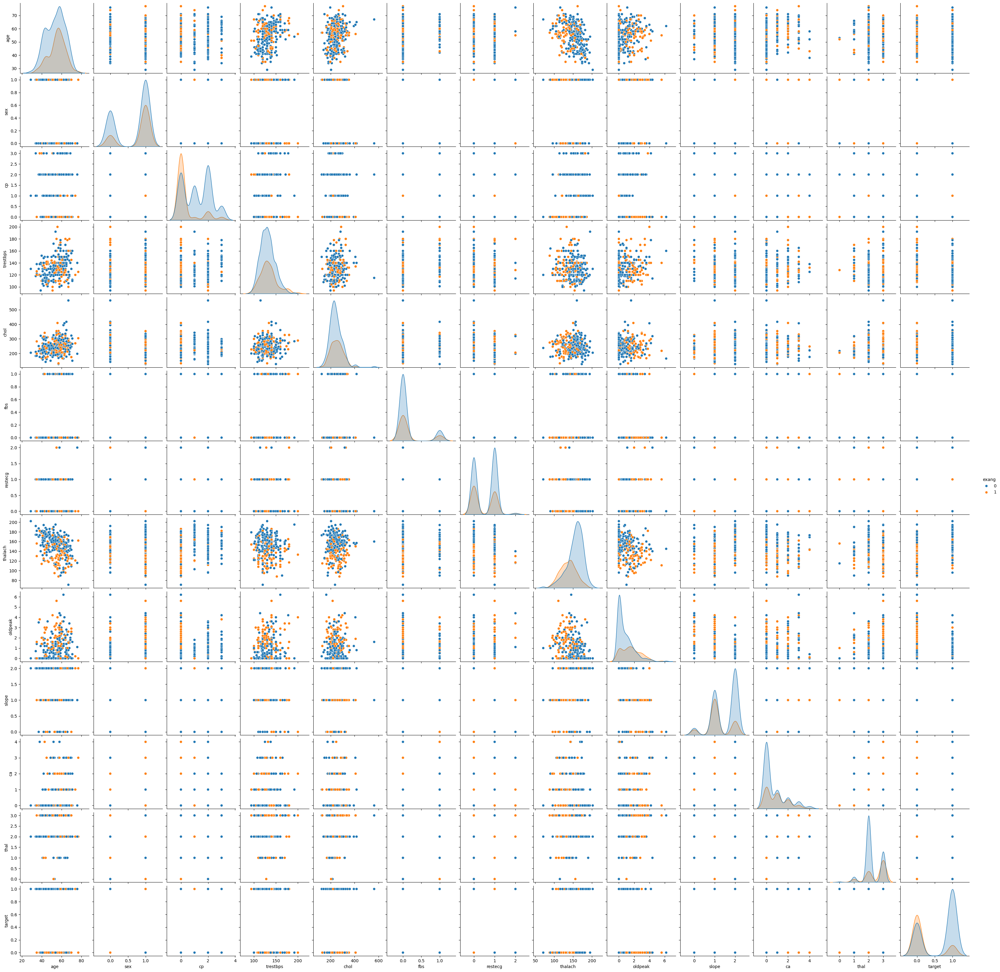

In [ ]:
sns.pairplot(data,hue='exang')

#### oldpeak

(oldpeak
 0.0    329
 0.1     23
 0.2     37
 0.3     10
 0.4     30
 0.5     15
 0.6     47
 0.7      3
 0.8     44
 0.9     10
 1.0     51
 1.1      6
 1.2     58
 1.3      3
 1.4     44
 1.5     16
 1.6     37
 1.8     36
 1.9     16
 2.0     32
 2.1      3
 2.2     14
 2.3      7
 2.4     11
 2.5      7
 2.6     21
 2.8     22
 2.9      3
 3.0     17
 3.1      4
 3.2      8
 3.4     10
 3.5      3
 3.6     15
 3.8      4
 4.0     12
 4.2      6
 4.4      4
 5.6      4
 6.2      3
 dtype: int64,
 <Axes: xlabel='oldpeak', ylabel='count'>)

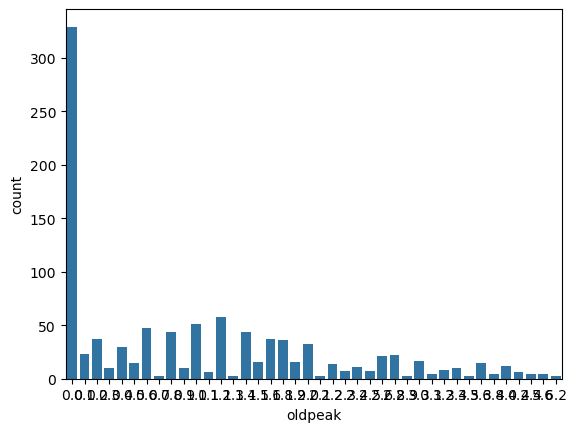

In [ ]:
data.groupby('oldpeak').size() , sns.countplot(x='oldpeak', data=data)

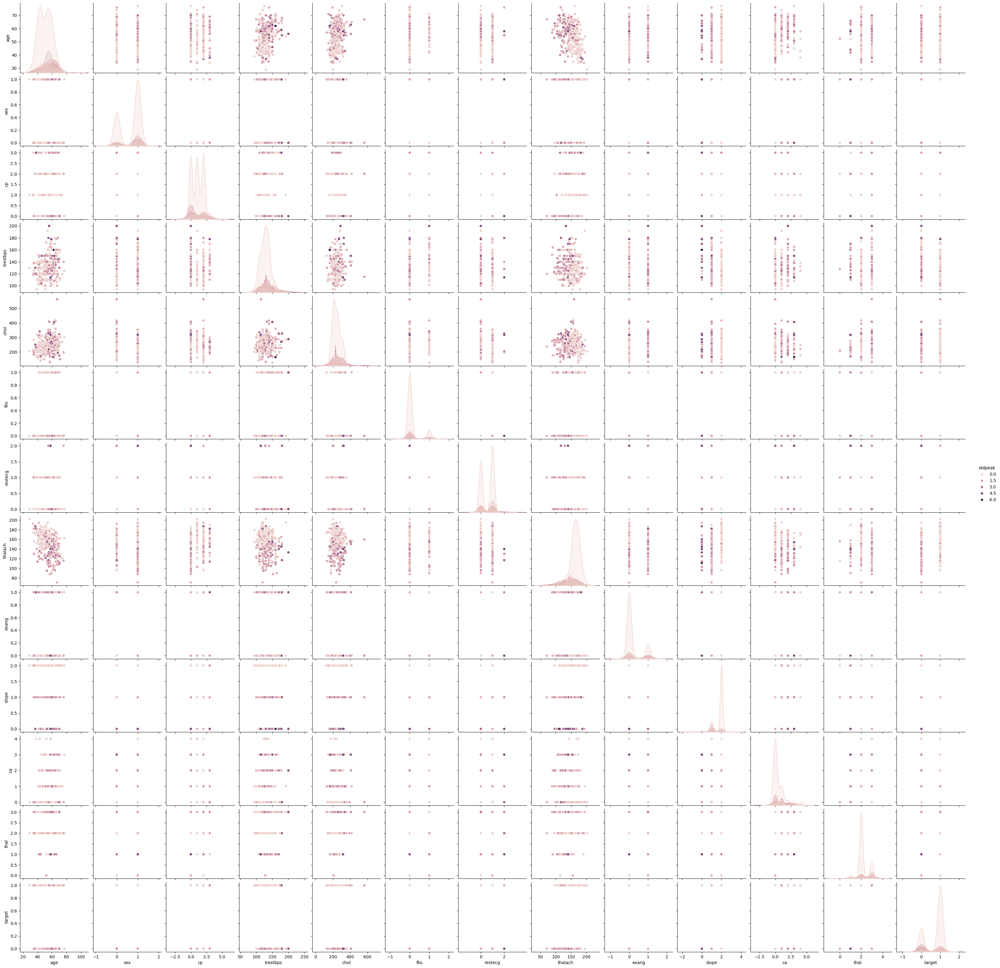

In [ ]:
sns.pairplot(data,hue='oldpeak')

#### slope

(slope
 0     74
 1    482
 2    469
 dtype: int64,
 <Axes: xlabel='slope', ylabel='count'>)

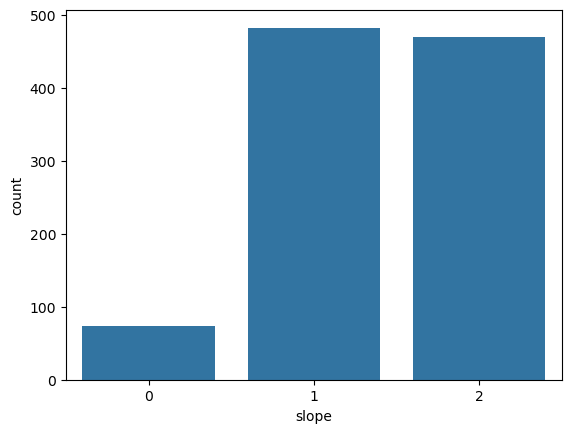

In [ ]:
data.groupby('slope').size() , sns.countplot(x='slope', data=data)

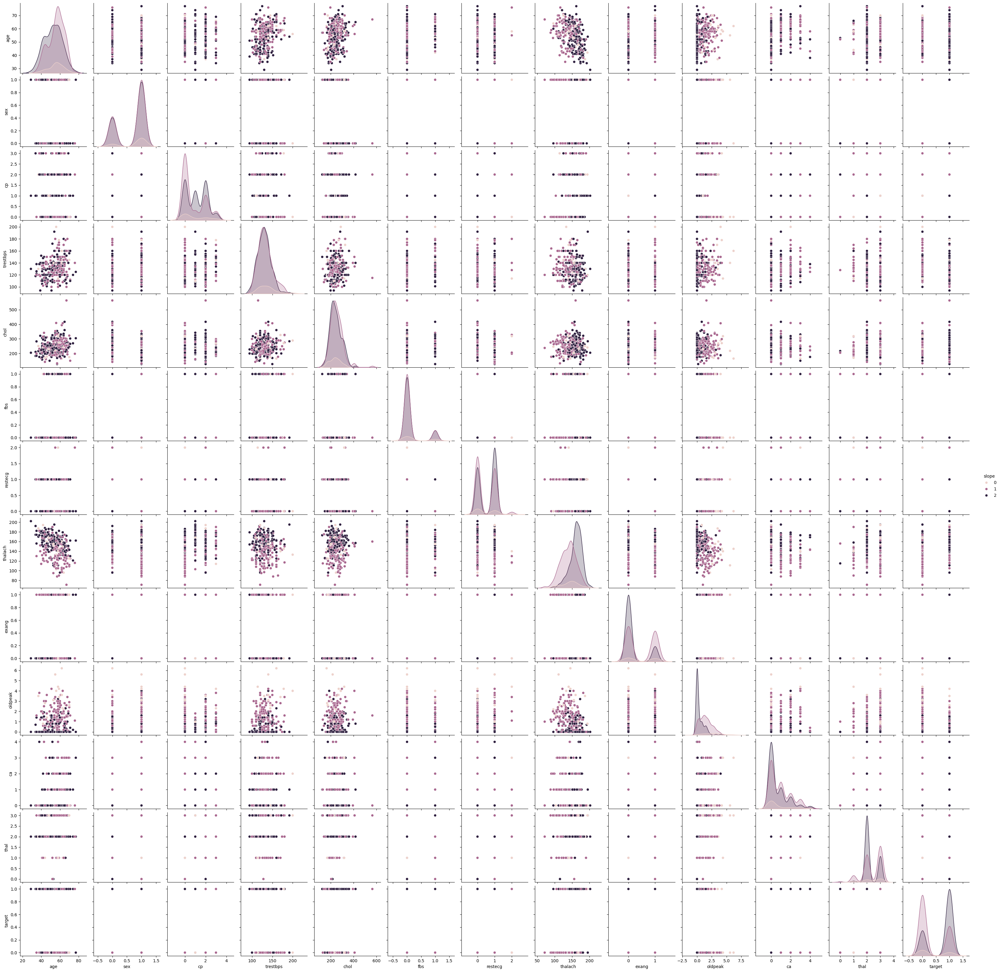

In [ ]:
sns.pairplot(data,hue='slope')

#### ca

(ca
 0    578
 1    226
 2    134
 3     69
 4     18
 dtype: int64,
 <Axes: xlabel='ca', ylabel='count'>)

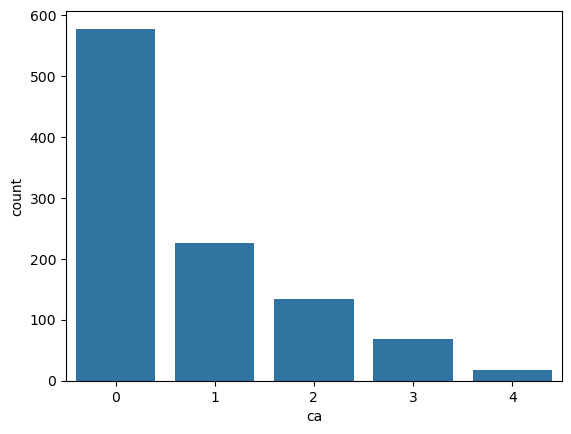

In [ ]:
data.groupby('ca').size() , sns.countplot(x='ca', data=data)

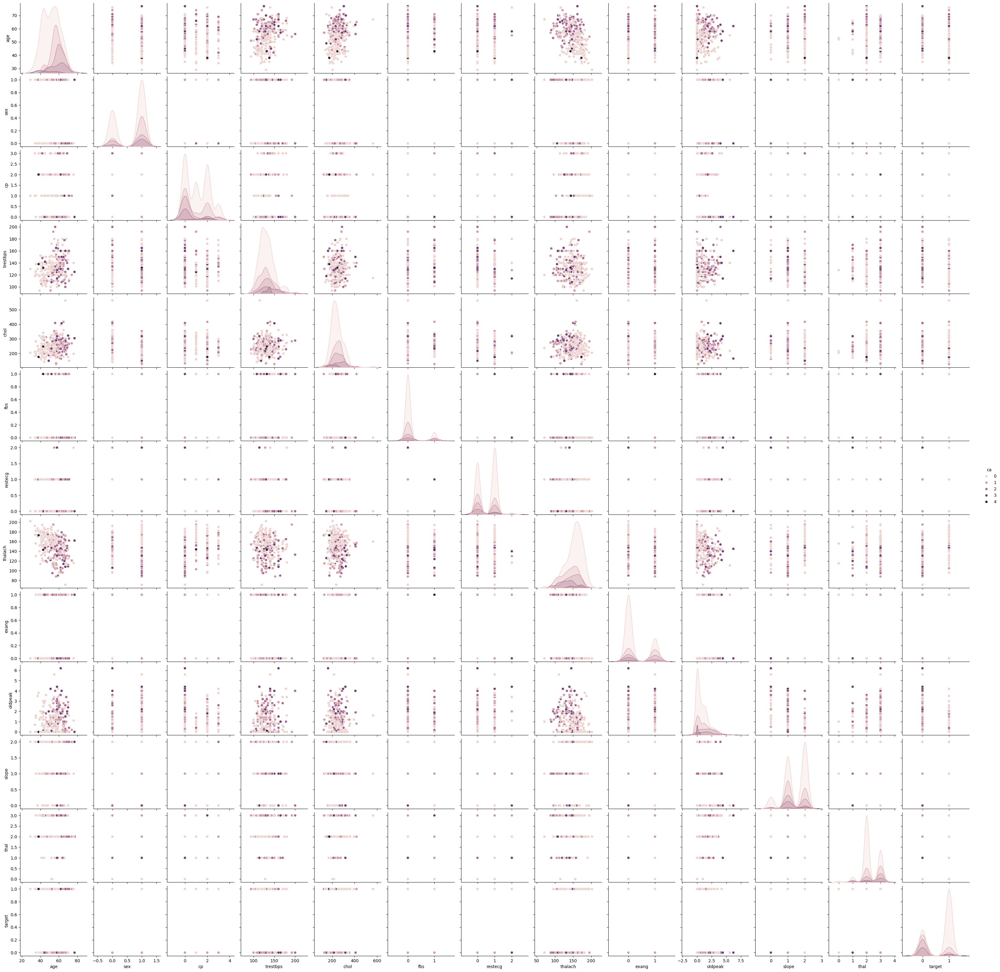

In [ ]:
sns.pairplot(data,hue='ca')

#### thal

(thal
 0      7
 1     64
 2    544
 3    410
 dtype: int64,
 <Axes: xlabel='thal', ylabel='count'>)

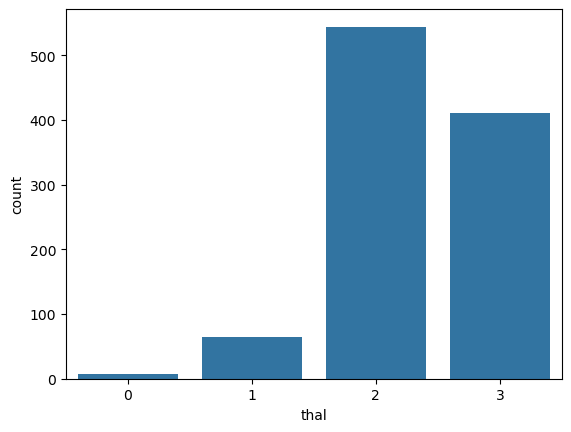

In [ ]:
data.groupby('thal').size() , sns.countplot(x='thal', data=data)

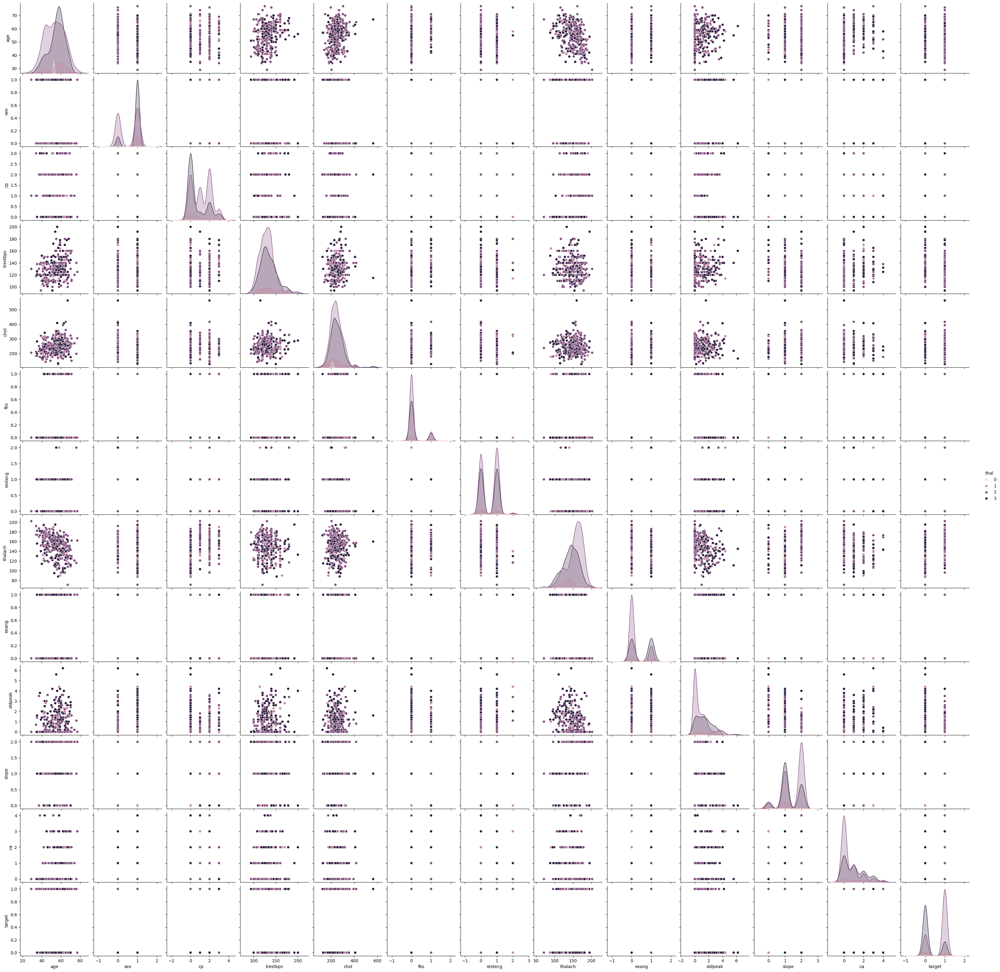

In [ ]:
sns.pairplot(data,hue='thal')

#### target

(target
 0    499
 1    526
 dtype: int64,
 <Axes: xlabel='target', ylabel='count'>)

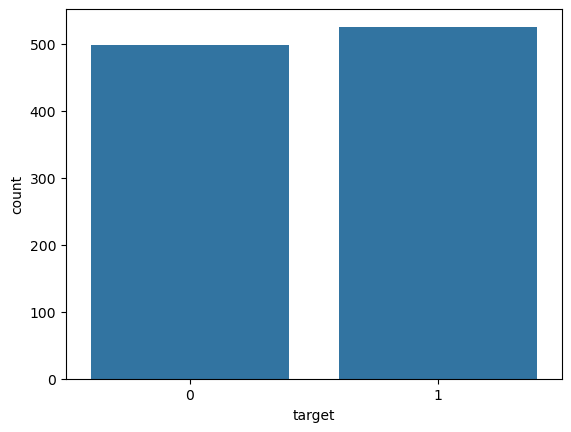

In [ ]:
data.groupby('target').size() , sns.countplot(x='target', data=data)

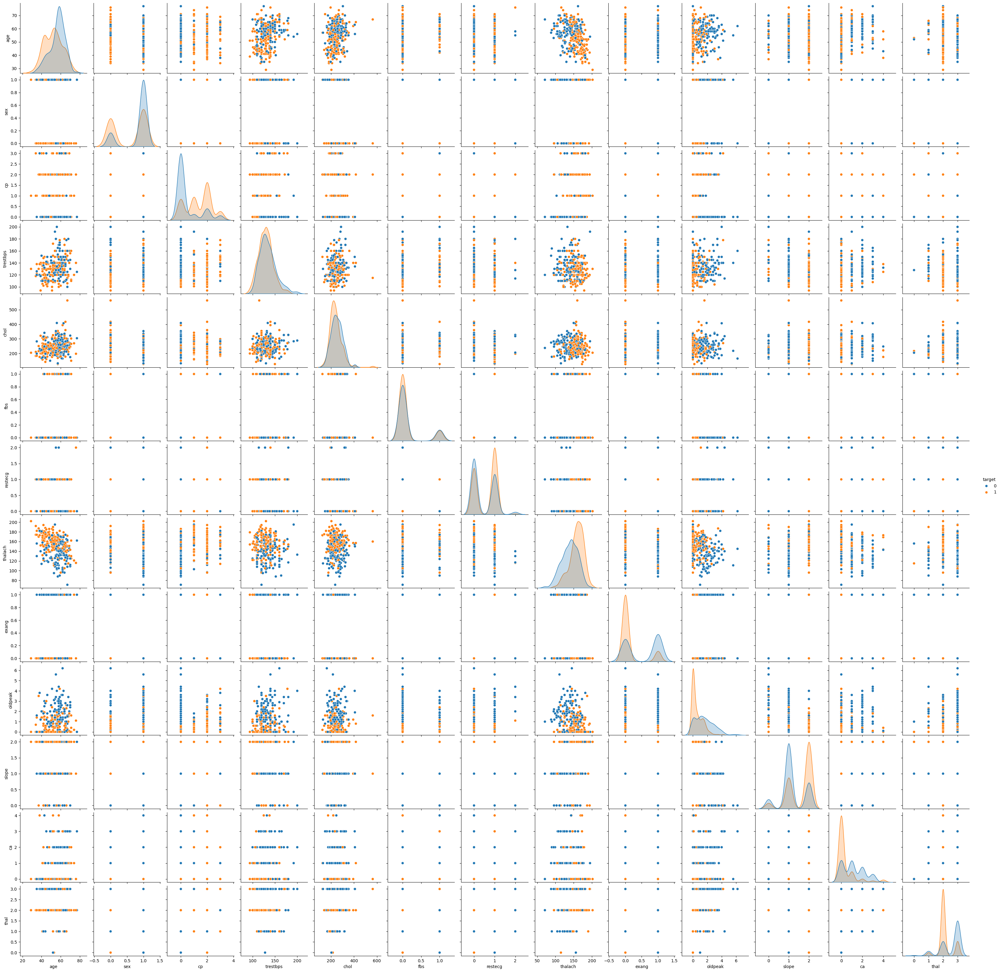

In [ ]:
sns.pairplot(data,hue='target')

## Preprocessing

In [79]:
X=np.array(data.loc[:,data.columns!='target'])
y=np.array(data.loc[:,data.columns=='target'])

X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=24)
print(X_train.shape, y_train.shape, X_test.shape, y_test.shape)
print(y_train.ravel().shape)
print(y_test.ravel().shape)
y_train = y_train.ravel()
y_test = y_test.ravel()

(820, 13) (820, 1) (205, 13) (205, 1)
(820,)
(205,)


In [75]:
from sklearn.preprocessing import (
    MaxAbsScaler,
    MinMaxScaler,
    Normalizer,
    PowerTransformer,
    QuantileTransformer,
    RobustScaler,
    StandardScaler,
    minmax_scale,
)

In [80]:
#scaler=StandardScaler()
#scaler.fit_transform(X_train)
#X_test = scaler.transform(X_test)
clf=GaussianNB()

clf.fit(X_train,y_train)
y_pred =clf.predict(X_test)

##

              precision    recall  f1-score   support

           0       0.80      0.83      0.81        87
           1       0.87      0.85      0.86       118

    accuracy                           0.84       205
   macro avg       0.83      0.84      0.84       205
weighted avg       0.84      0.84      0.84       205

0.8390243902439024
[[ 72  15]
 [ 18 100]]


Text(70.72222222222221, 0.5, 'True labels')

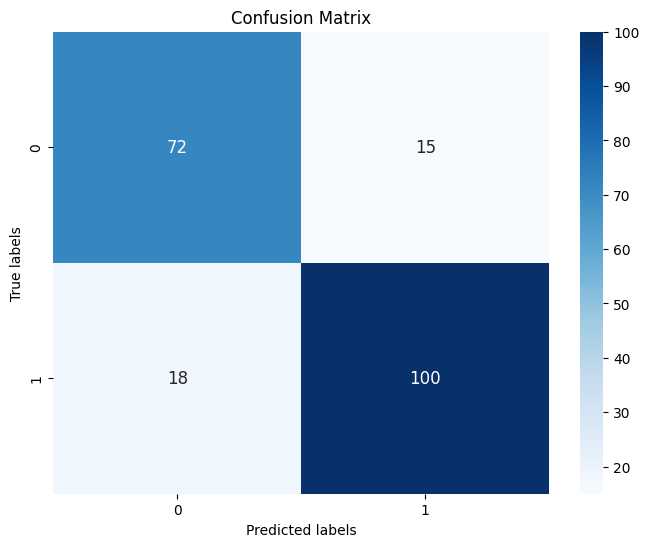

In [81]:

cl_rep =classification_report(y_pred , y_test)
cm = confusion_matrix(y_pred , y_test)
score = accuracy_score(y_pred , y_test)
print(cl_rep)
print(score)
print(cm)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', annot_kws={"size": 12})
plt.title('Confusion Matrix')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')



In [82]:
print(accuracy_score(y_pred,y_test))


0.8390243902439024


In [83]:
print(jaccard_score(y_pred,y_test))
print(jaccard_score(y_pred,y_test,average='micro'))
print(jaccard_score(y_pred,y_test,average='macro'))

0.7518796992481203
0.7226890756302521
0.718796992481203


In [84]:
print(f1_score(y_pred,y_test))
print(f1_score(y_pred,y_test,average='micro'))
print(f1_score(y_pred,y_test,average='macro'))

0.8583690987124463
0.8390243902439024
0.8359642103731723


In [85]:
print(precision_score(y_pred,y_test))
print(precision_score(y_pred,y_test,average='micro'))
print(precision_score(y_pred,y_test,average='macro'))

0.8695652173913043
0.8390243902439024
0.8347826086956522


In [86]:
print(recall_score(y_pred,y_test))
print(recall_score(y_pred,y_test,average='micro'))
print(recall_score(y_pred,y_test,average='macro'))


0.847457627118644
0.8390243902439024
0.8375219170075978


In [88]:
# Select 5 random indices from the testing set
random_indices = np.random.choice(len(X_test), 5, replace=False)

# Extract features and labels for the selected indices
X_random = X_test[random_indices]
y_random_true = y_test[random_indices]

# Predict labels for the selected features
y_random_pred = clf.predict(X_random)

# Print true and predicted labels for the random data points
for i in range(len(random_indices)):
    print("Data Point", i+1)
    print("True Label:", y_random_true[i])
    print("Predicted Label:", y_random_pred[i])
    print()


Data Point 1
True Label: 1
Predicted Label: 1

Data Point 2
True Label: 0
Predicted Label: 0

Data Point 3
True Label: 0
Predicted Label: 0

Data Point 4
True Label: 0
Predicted Label: 0

Data Point 5
True Label: 0
Predicted Label: 0

